In [ ]:
from static import *
from bao import *

with open(PATH_DICTIONARY, "r") as a:
    name_dict = json.load(a)

## Load data

In [2]:
stock_data = clean_daily_data(path_stock_data, path_ticker, name_dict)

## Calculate market simple return and log return

In [4]:
market = (
    stock_data.groupby(["exchange", "time"])[
        [
            "return_weighted",
            "log_return_weighted",
        ]
    ]
    .sum()
    .reset_index()
)

# test data

## outliner remove

In [5]:
from scipy.stats.mstats import winsorize
import statsmodels.api as sm
import statsmodels.formula.api as smf

'DELISTED'

{'whiskers': [<matplotlib.lines.Line2D at 0x7fd558080050>,
 'caps': [<matplotlib.lines.Line2D at 0x7fd558105310>,
 'boxes': [<matplotlib.lines.Line2D at 0x7fd558105090>],
 'medians': [<matplotlib.lines.Line2D at 0x7fd558105590>],
 'fliers': [<matplotlib.lines.Line2D at 0x7fd5581056d0>],
 'means': []}

Text(0.5, 1.0, 'Box Plot of Stock Returns')

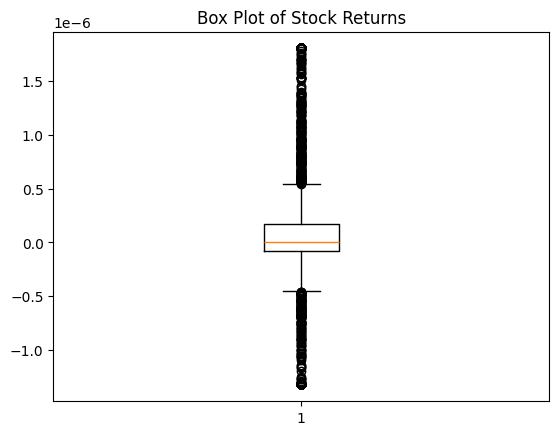

number of outliner with z_score >3 is 0


'HNX'

{'whiskers': [<matplotlib.lines.Line2D at 0x7fd558072850>,
 'caps': [<matplotlib.lines.Line2D at 0x7fd558072ad0>,
 'boxes': [<matplotlib.lines.Line2D at 0x7fd558072710>],
 'medians': [<matplotlib.lines.Line2D at 0x7fd558072d50>],
 'fliers': [<matplotlib.lines.Line2D at 0x7fd558072e90>],
 'means': []}

Text(0.5, 1.0, 'Box Plot of Stock Returns')

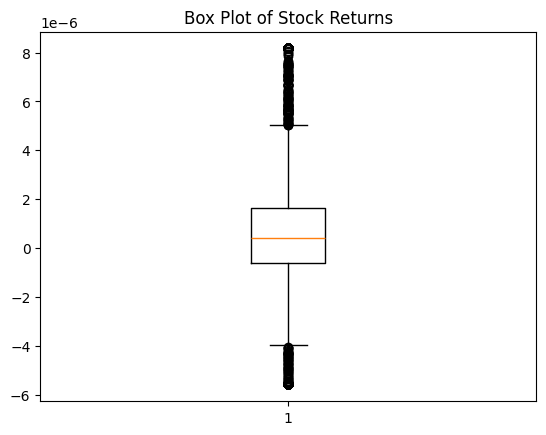

number of outliner with z_score >3 is 0


'HSX'

{'whiskers': [<matplotlib.lines.Line2D at 0x7fd5507db9d0>,
 'caps': [<matplotlib.lines.Line2D at 0x7fd5507dbc50>,
 'boxes': [<matplotlib.lines.Line2D at 0x7fd5507db890>],
 'medians': [<matplotlib.lines.Line2D at 0x7fd5507dbed0>],
 'fliers': [<matplotlib.lines.Line2D at 0x7fd5507b0050>],
 'means': []}

Text(0.5, 1.0, 'Box Plot of Stock Returns')

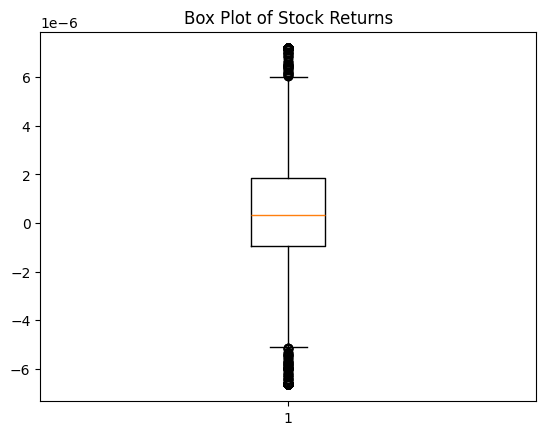

number of outliner with z_score >3 is 0


'UPCOM'

{'whiskers': [<matplotlib.lines.Line2D at 0x7fd5507ebc50>,
 'caps': [<matplotlib.lines.Line2D at 0x7fd5507ebed0>,
 'boxes': [<matplotlib.lines.Line2D at 0x7fd5507ebb10>],
 'medians': [<matplotlib.lines.Line2D at 0x7fd550300190>],
 'fliers': [<matplotlib.lines.Line2D at 0x7fd5503002d0>],
 'means': []}

Text(0.5, 1.0, 'Box Plot of Stock Returns')

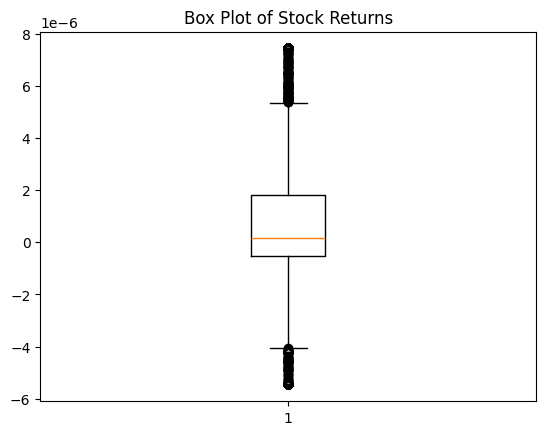

number of outliner with z_score >3 is 0


In [6]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

for i in market["exchange"].unique():
    returns = market[market["exchange"] == i]["return_weighted"]
    # Detect outliers using Z-score
    i
    returns = winsorize(returns, limits=[0.05, 0.05])
    z_scores = np.abs((returns - returns.mean()) / returns.std())
    outliers = returns[z_scores > 3]
    # Visualize outliers
    plt.boxplot(returns)
    plt.title("Box Plot of Stock Returns")
    plt.show()
    print(f"number of outliner with z_score >3 is {len(outliers)}")

## Stationary


In [8]:
for i in market["exchange"].unique():
    temp = market[market["exchange"] == i]["return_weighted"]
    returns = winsorize(temp, limits=[0.05, 0.05])
    print(i)
    adf_test(temp, 0.01)
    kpss_test(temp, 0.01)

DELISTED
ADF Test Results:
ADF Statistic: -5.6653246373946455
p-value: 9.179898357429256e-07
Critical Value (1%): -3.4325853286163874
Critical Value (5%): -2.8625276197775373
Critical Value (10%): -2.5672957374856296
Judgment: The series is likely stationary (Reject null hypothesis).


KPSS Test Results:
KPSS Statistic: 0.6065963107295933
p-value: 0.022036699024582426
Critical Value (10%): 0.347
Critical Value (5%): 0.463
Critical Value (2.5%): 0.574
Critical Value (1%): 0.739
Judgment: The series is likely stationary (Fail to reject null hypothesis).


HNX
ADF Test Results:
ADF Statistic: -6.466298380247844
p-value: 1.402538851500631e-08
Critical Value (1%): -3.4325860929804404
Critical Value (5%): -2.8625279573644873
Critical Value (10%): -2.5672959172141048
Judgment: The series is likely stationary (Reject null hypothesis).


KPSS Test Results:
KPSS Statistic: 2.4515047096145235
p-value: 0.01
Critical Value (10%): 0.347
Critical Value (5%): 0.463
Critical Value (2.5%): 0.574
Critica

## Seasonarity



'DELISTED'

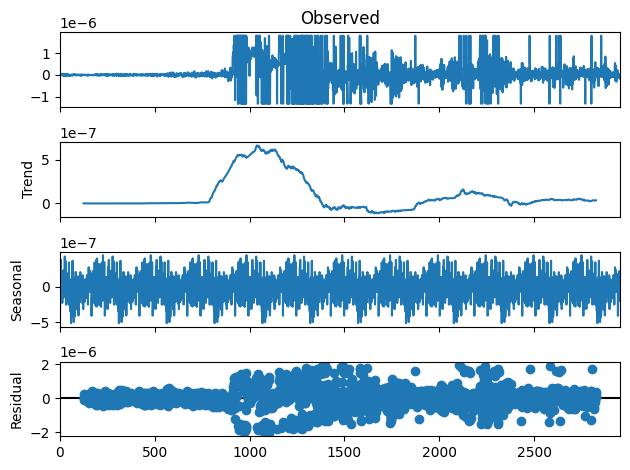

'HNX'

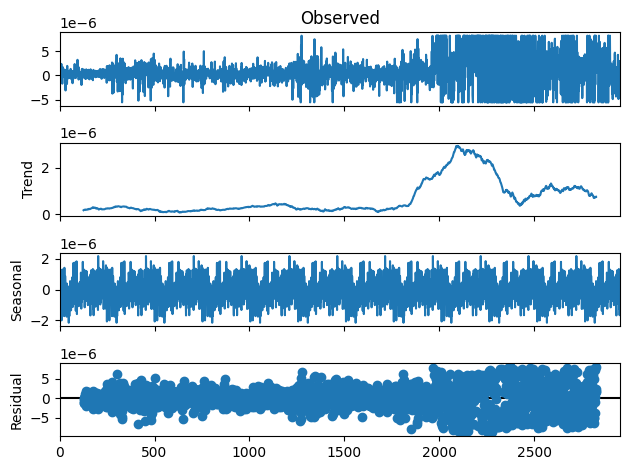

'HSX'

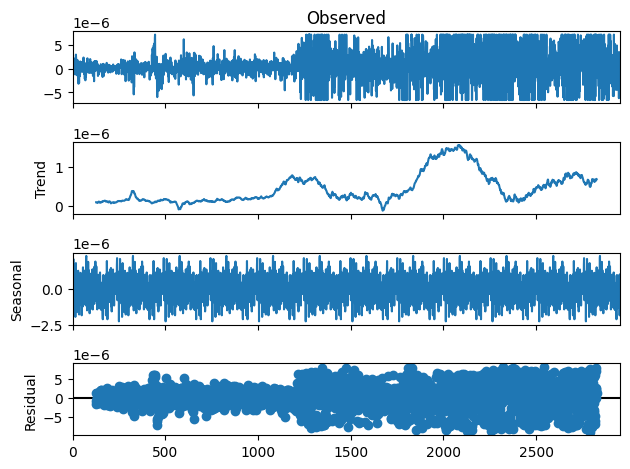

'UPCOM'

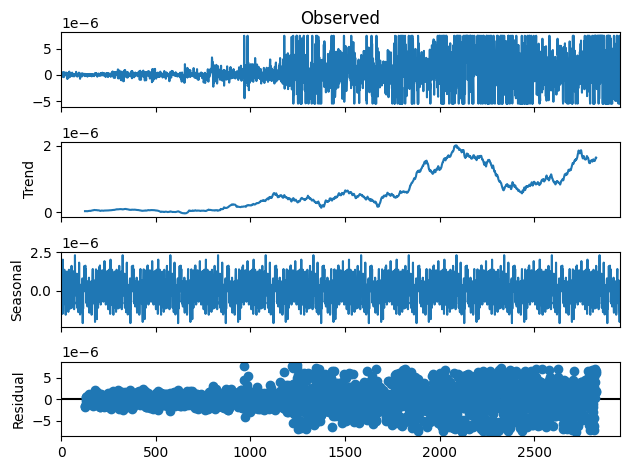

In [7]:
from statsmodels.tsa.seasonal import seasonal_decompose
import matplotlib.pyplot as plt
for i in market["exchange"].unique():
    temp = market[market["exchange"] == i]["return_weighted"]
    temp = winsorize(temp, limits=[0.05, 0.05])
    i
    result = seasonal_decompose(temp, model="additive", period=252)
    result.plot()
    plt.close()

DELISTED


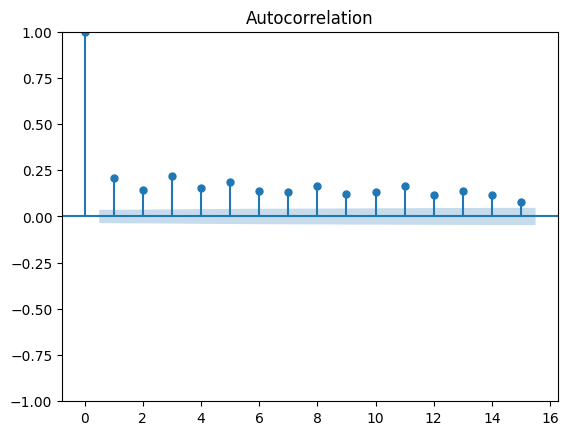

HNX


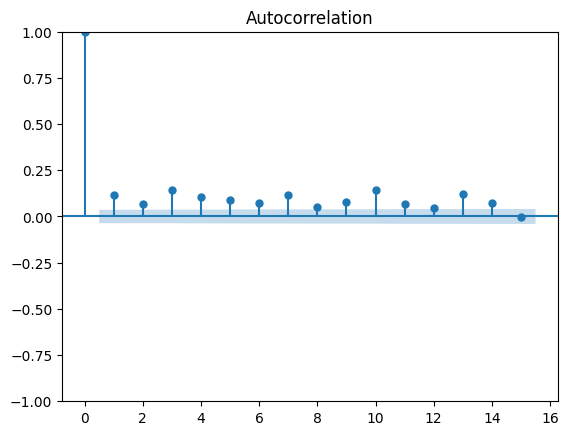

HSX


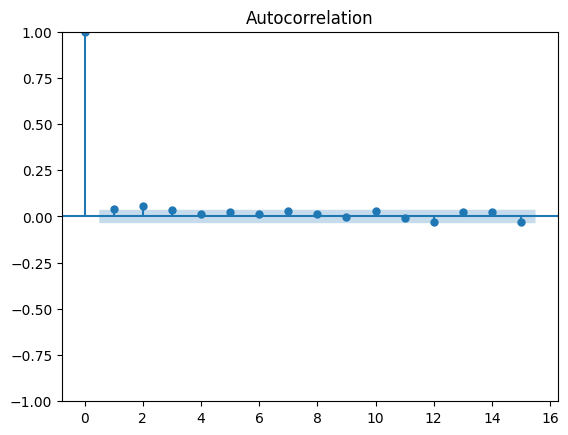

UPCOM


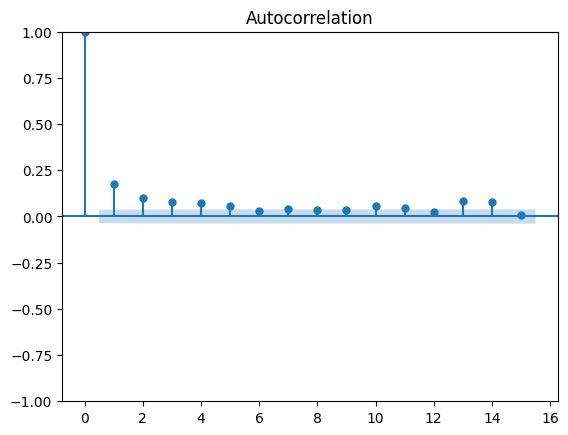

In [9]:
for i in market["exchange"].unique():
    temp = market[market["exchange"] == i]["return_weighted"]
    temp = winsorize(temp, limits=[0.05, 0.05])
    print(i)
    plot_acf(temp, lags=15)
    plt.close()

In [18]:
windows = [10, 30, 70, 120, 200]
for i in market["exchange"].unique():
    temp = market[market["exchange"] == i]
    temp["return_weighted"] = winsorize(
        temp["return_weighted"], limits=[0.05, 0.05]
    )
    temp["log_return_weighted"] = winsorize(
        temp["log_return_weighted"], limits=[0.05, 0.05]
    )
    print(i)
    draw_SMA(temp, "return_weighted", windows)
    draw_EMA(temp, "return_weighted", windows)
    draw_cummulative(temp, "log_return_weighted", windows)

DELISTED


HNX


HSX


UPCOM


In [19]:
for i in market["exchange"].unique():
    temp = market[market["exchange"] == i]
    print(i)
    AR_visualize(temp["return_weighted"], 1, 500)

DELISTED
const                 0.300117
return_weighted.L1    0.920915
dtype: float64
const                 0.000001
return_weighted.L1    0.004444
dtype: float64


HNX
const                 0.026555
return_weighted.L1    0.216521
dtype: float64
const                 6.005047e-07
return_weighted.L1    5.523584e-02
dtype: float64


HSX
const                 0.070796
return_weighted.L1    0.990443
dtype: float64
const                 4.684720e-07
return_weighted.L1   -5.362201e-04
dtype: float64


UPCOM
const                 1.552775e-03
return_weighted.L1    2.606309e-07
dtype: float64
const                 9.408394e-07
return_weighted.L1    2.251691e-01
dtype: float64


In [11]:
# Find the best parameter for ARIMA (p,d,q)
# p for auto regression
# d for seasonal or higher differentation
# q for lag error in prediction
import itertools

# Define the set of numbers
numbers = [0, 1, 2]

# Generate all combinations of 3 numbers taken 3 at a time
combinations = list(itertools.product(numbers, repeat=3))

In [34]:
# try to visualize whole data with one of method: aic. bic. rmse, and mape
for i in market["exchange"].unique():
    temp = market[market["exchange"] == i]
    temp["return_weighted"] = winsorize(
        temp["return_weighted"], limits=[0.05, 0.05]
    )
    temp["log_return_weighted"] = winsorize(
        temp["log_return_weighted"], limits=[0.05, 0.05]
    )
    print(i)
    ARIMA_visualize(
        temp["log_return_weighted"], [(1, 0, 1)], 1500, "aic"
    )

DELISTED
Order (1, 0, 1): AIC = -31770.38474473057

Best Model Order: (1, 0, 1)
Best Model AIC: -31770.38474473057
P-values: const     0.999713
ar.L1     0.000000
ma.L1     0.000000
sigma2    0.050695
dtype: float64
Parameters: const     2.414697e-09
ar.L1     5.126829e-01
ma.L1    -3.842145e-01
sigma2    1.000000e-10
dtype: float64


([np.float64(-31770.38474473057)], (1, 0, 1))

HNX
Order (1, 0, 1): AIC = -32679.83458707642

Best Model Order: (1, 0, 1)
Best Model AIC: -32679.83458707642
P-values: const     1.729559e-47
ar.L1     0.000000e+00
ma.L1     0.000000e+00
sigma2    7.761434e-01
dtype: float64
Parameters: const    -2.031253e-06
ar.L1     6.055404e-01
ma.L1    -4.997350e-01
sigma2    1.641495e-11
dtype: float64


([np.float64(-32679.83458707642)], (1, 0, 1))

HSX
Order (1, 0, 1): AIC = -31538.00205334514

Best Model Order: (1, 0, 1)
Best Model AIC: -31538.00205334514
P-values: const     0.460564
ar.L1     0.000000
ma.L1     0.000000
sigma2    0.052299
dtype: float64
Parameters: const     5.260171e-07
ar.L1     6.899279e-01
ma.L1    -6.604204e-01
sigma2    1.000000e-10
dtype: float64


([np.float64(-31538.00205334514)], (1, 0, 1))

UPCOM
Order (1, 0, 1): AIC = -32773.83430168506

Best Model Order: (1, 0, 1)
Best Model AIC: -32773.83430168506
P-values: const     1.158956e-56
ar.L1     0.000000e+00
ma.L1     0.000000e+00
sigma2    8.074964e-01
dtype: float64
Parameters: const    -2.041874e-06
ar.L1     4.902401e-01
ma.L1    -3.350867e-01
sigma2    1.405007e-11
dtype: float64


([np.float64(-32773.83430168506)], (1, 0, 1))

## next step: try to visulize with data available in each time step only instead of full dataset